## Подключение библиотек

In [1]:
#IMPORT LIBS 

import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

import torch
import torch.nn as nn
from torch import optim
from torch.utils.data import DataLoader

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

import utils
import unet
import net_process
import showing

# Загрузка изображений

Сначала загрузим исходные изображения:

In [2]:
images, images_names = utils.download('training')

Просмотр нескольких изображений:

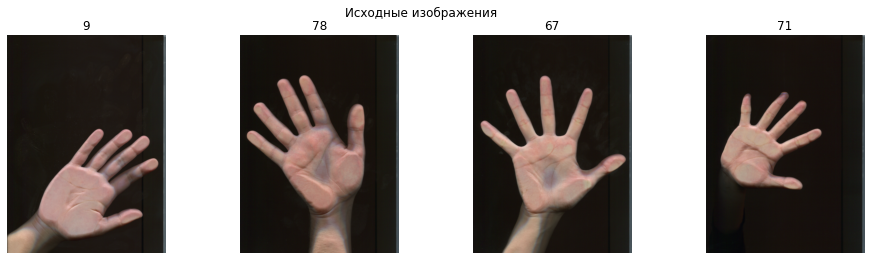

In [3]:
showing.show_images(images, images_names)

Номера соответствуют правильным именам из директории

# Сегментация

## Создание тренировочных масок

Далее для некоторых (а именно десяти последних) определяются маски, после чего сет из десяти сэмплов (изображение - маска) отправляется на аугментацию для последующей генерации датасета нейросети.

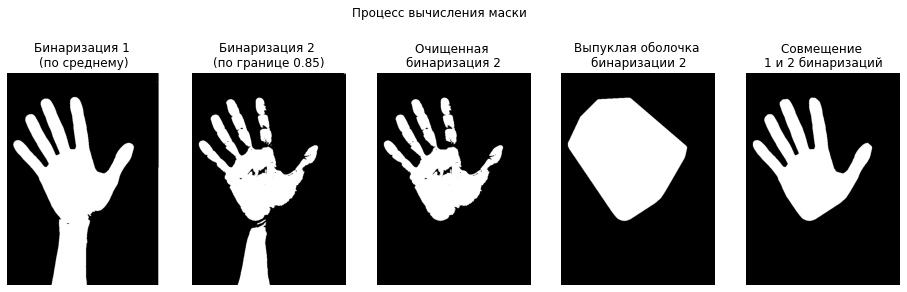

In [4]:
showing.show_making_mask(images[-2])

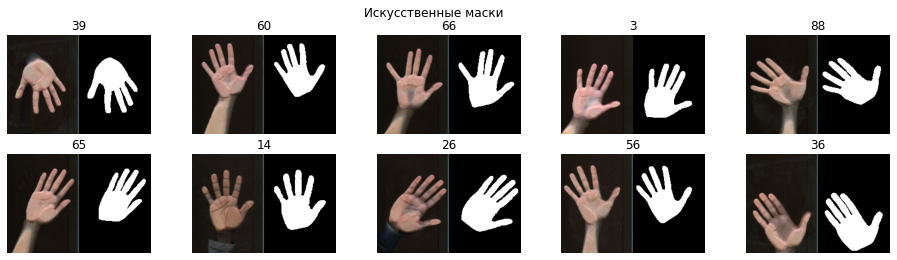

In [5]:
showing.show_artificial_mask(images[-10:], images_names[-10:])

## Генерация и сохранение датасета:

(Нет необходимости генерировать заново, все картинки есть в папках train_img и train_mask)

In [6]:
# %mkdir train_img
# %mkdir train_mask

# utils.generate_train_dataset(images[-10:], 'train_img', 'train_mask')

Загрузчики датасета для сети:

In [7]:
tr = utils.Compose(utils.ToTensor(), utils.Normalize())

train_dataset = utils.MyDataset(
    img_dir='train_img/',
    mask_dir='train_mask/', 
    transforms=tr
)

train_data_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)

Просмотр некоторых сэмплов из train_dataset:

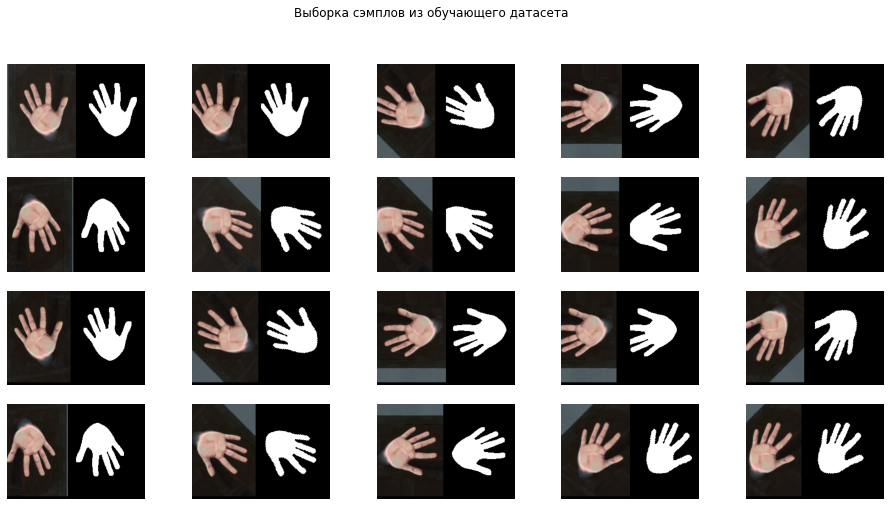

In [8]:
showing.show_dataset_samples(train_dataset)

## Тренировка сети UNET

Обучение сети: **Для тестирования выберите пункт "загрузка сети"**

In [9]:
# %%time

# net = unet.UNet().to(device)
# net = nn.DataParallel(net)
# opt = optim.Adam(net.parameters(), lr=1e-05)

# criterion = nn.BCEWithLogitsLoss()
# loss, accuracy = net_process.train(net, train_data_loader, opt, device,
#                        criterion, num_epochs=5, verbose_num_iters=5)
# print(f'Loss: {loss:.3f}, Accuracy: {accuracy:.3f}')

In [10]:
# torch.save(net, 'net')

**Загрузка сети**

In [11]:
model = torch.load('net')
model.eval()

DataParallel(
  (module): UNet(
    (encoder): VGG13Encoder(
      (blocks): ModuleList(
        (0): Sequential(
          (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (1): ReLU(inplace=True)
          (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (3): ReLU(inplace=True)
        )
        (1): Sequential(
          (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (1): ReLU(inplace=True)
          (2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (3): ReLU(inplace=True)
        )
        (2): Sequential(
          (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (1): ReLU(inplace=True)
          (2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
          (3): ReLU(inplace=True)
        )
        (3): Sequential(
          (0): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  

## Результаты сегментации:

In [12]:
masks = net_process.segmentation_list(images, model, tr)

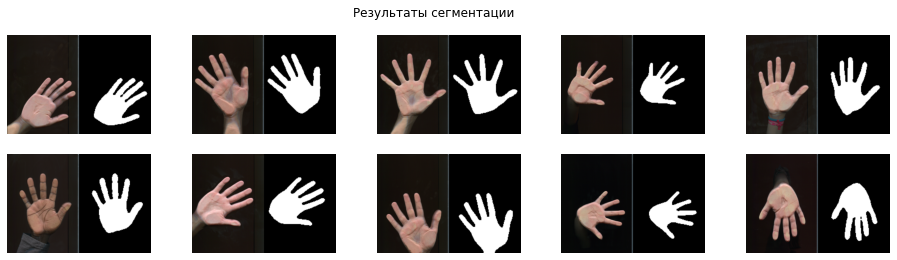

In [13]:
showing.show_segmentation_results(images[:10], masks[:10])

Как видно, сеть очень хорошо научилась сегментировать ладони.

# Векторизация

## Вычисление длины и ширины

Как и сказано в отчете, процесс вычисления длины включает в себя сегментацию пальцев.

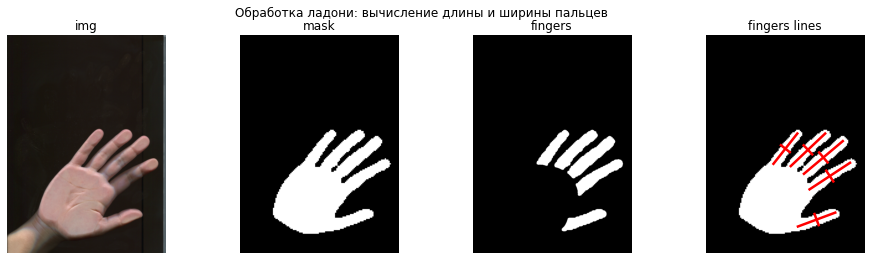

In [14]:
showing.show_fingers_processing(images[0], model, tr)

Заметим, что любые методы определения ключевых точек (tips и valleys) будут выдавать ошибку на "склеенных" пальцах. Это надо учитывать в алгоритме. Ниже приведена визуализация способа устранить проблему:

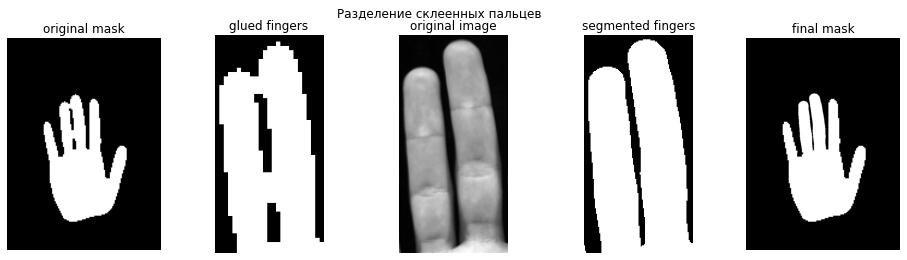

In [15]:
showing.show_separated_fingers(images[77], masks[77], 180, 380, 170, 270)

Результаты выделения пальцев и определения их длины и ширины.

In [16]:
codes, lines = net_process.coding_list(images, masks)

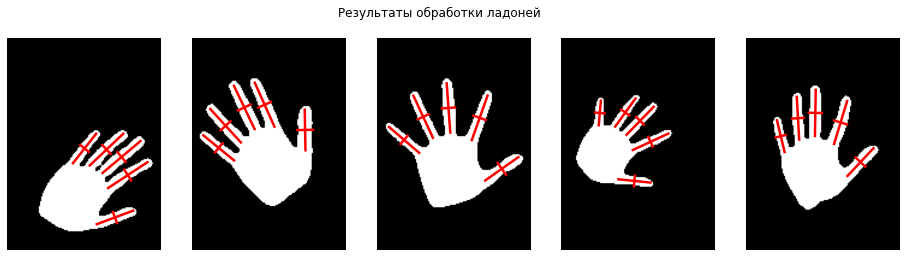

In [17]:
showing.show_fingers_processing_results(masks[:5], lines[:5])

## Спектральный анализ

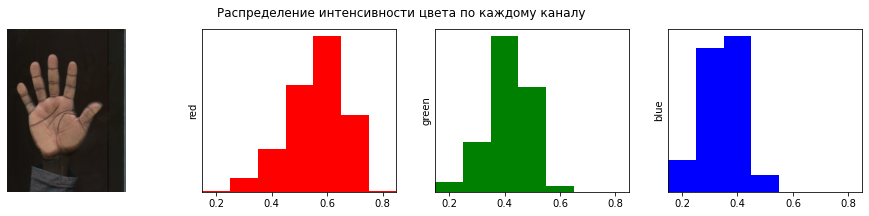

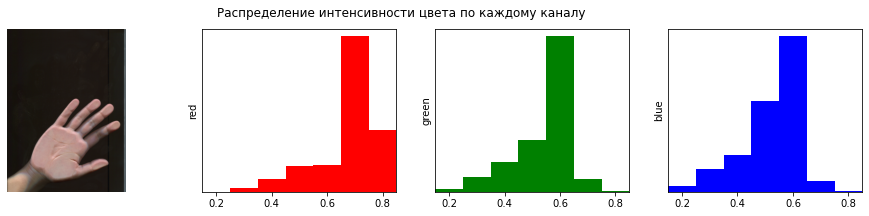

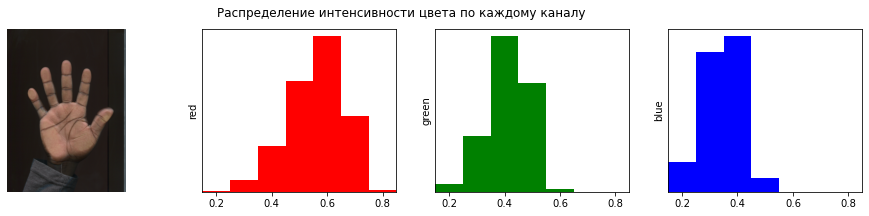

In [18]:
showing.show_colors_hist(images[10], masks[10])
showing.show_colors_hist(images[0], masks[0])
showing.show_colors_hist(images[5], masks[5])

## Результаты векторизации изображений

In [19]:
df = pd.DataFrame(codes)
df

,l_1,w_1,l_2,w_2,l_3,w_3,l_4,w_4,l_5,w_5,...,g_0.6,g_0.7,g_0.8,b_0.2,b_0.3,b_0.4,b_0.5,b_0.6,b_0.7,b_0.8
0,124.84,36.33,128.85,38.52,153.39,40.29,156.64,41.56,164.33,42.46,...,0.581,0.047,0.001,0.018,0.071,0.114,0.281,0.482,0.033,0.001
1,131.64,39.03,134.87,52.54,150.71,43.62,158.96,46.22,159.78,45.77,...,0.198,0.008,0.000,0.007,0.076,0.314,0.516,0.087,0.000,0.000
2,132.04,36.37,134.31,47.14,154.36,38.99,156.93,42.96,163.99,43.93,...,0.568,0.091,0.004,0.002,0.016,0.117,0.599,0.242,0.024,0.000
3,82.43,31.90,107.05,35.43,115.04,32.26,129.47,36.00,130.26,35.11,...,0.542,0.064,0.005,0.024,0.074,0.151,0.469,0.265,0.016,0.001
4,108.70,34.43,126.30,44.16,141.98,38.78,148.92,44.65,153.09,43.24,...,0.548,0.134,0.001,0.007,0.025,0.083,0.401,0.458,0.026,0.000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94,105.76,37.12,128.79,35.30,152.31,38.27,160.23,42.11,163.25,39.24,...,0.556,0.054,0.001,0.007,0.055,0.157,0.551,0.213,0.016,0.000
95,105.79,54.61,115.46,36.50,143.87,45.60,149.69,43.49,156.20,48.31,...,0.020,0.000,0.000,0.088,0.406,0.455,0.051,0.000,0.000,0.000
96,135.66,40.66,142.19,44.79,162.88,43.82,171.33,41.08,174.68,43.49,...,0.182,0.001,0.000,0.038,0.143,0.349,0.429,0.041,0.000,0.000
97,127.52,34.91,141.18,45.47,148.74,36.90,161.38,43.19,162.81,39.78,...,0.638,0.076,0.000,0.001,0.020,0.114,0.569,0.292,0.004,0.000


# Кластеризация

## 3 ближайших соседа

In [20]:
neighbors_3, neighbors_3_true_names = net_process.k_neighbors(df, images_names, 3)

In [21]:
showing.show_3_neigbors_table(neighbors_3_true_names)

name,n_1,n_2,n_3
9,10,11,8
78,77,76,29
67,56,86,57
71,150,152,49
37,39,41,6
12,15,14,13
4,3,1,2
77,78,79,76
152,151,50,71
145,151,152,49


Визуализируем:

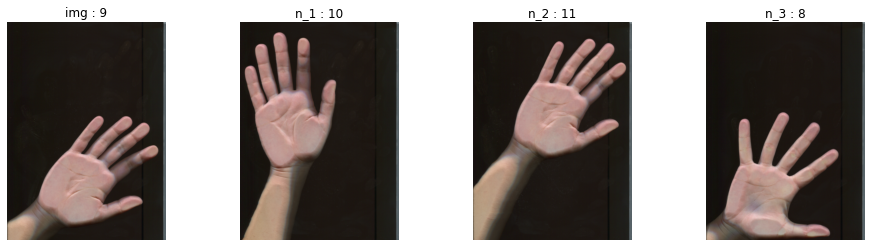

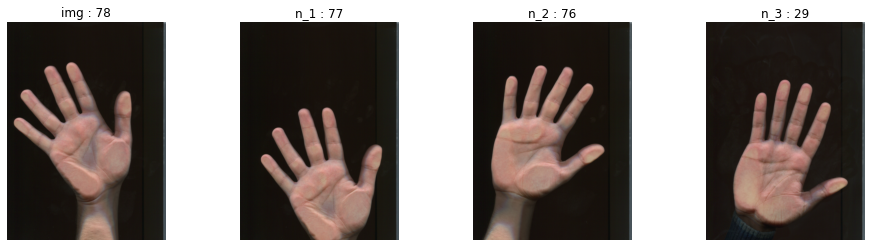

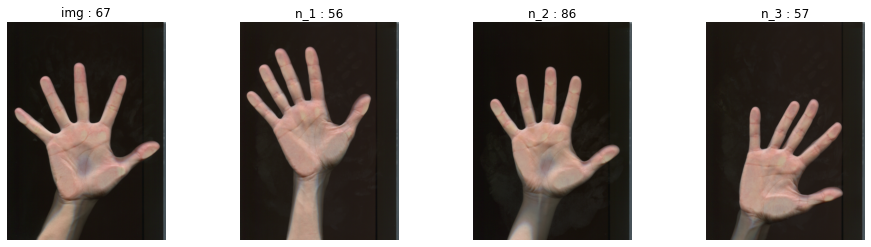

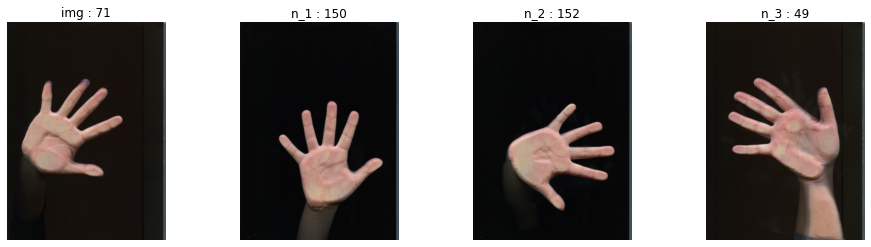

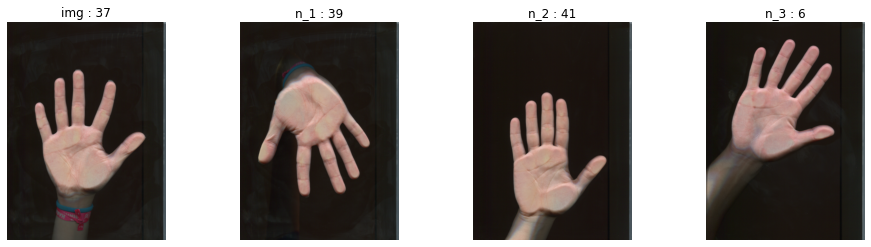

...

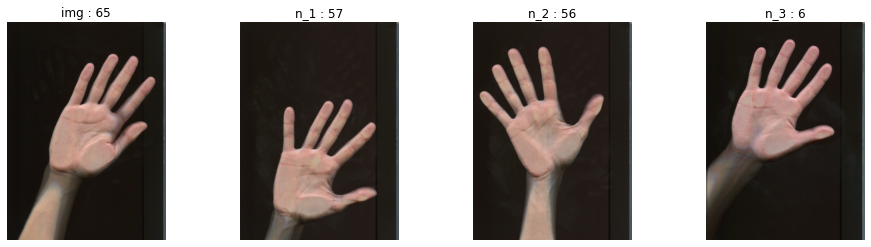

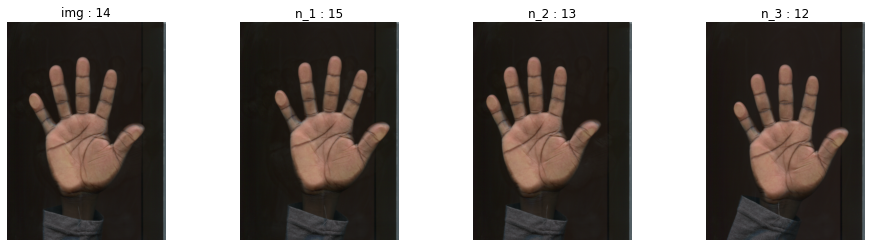

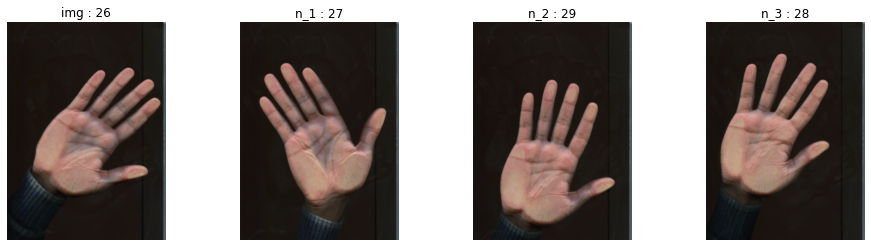

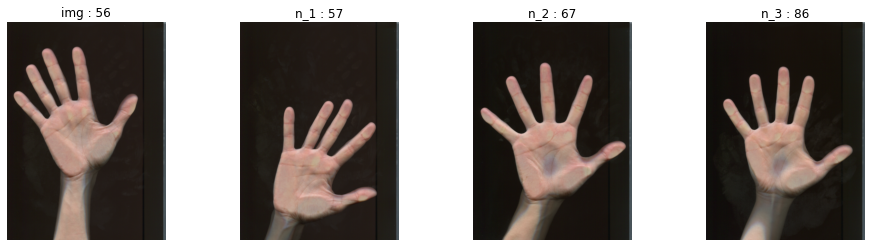

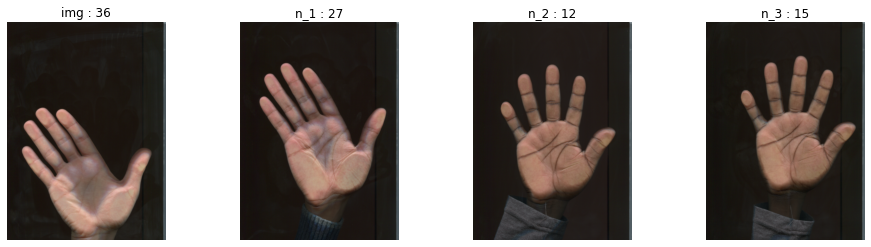

In [22]:
showing.show_3_neigbors_images(neighbors_3, images, images_names)

## Разделение на кластеры

In [23]:
clusters = net_process.clustering(neighbors_3_true_names)

In [24]:
showing.show_clusters_table(clusters)

name,,,,,,,
0,8,9,10,11,,,
1,76,77,46,78,79,,
2,65,67,86,56,57,88,
3,34,135,71,47,49,150,60
4,24,97,37,39,,,
5,12,13,14,15,,,
6,1,2,3,4,90,,
7,145,50,151,152,91,,
8,127,122,123,124,126,31,
name,,,,,,,


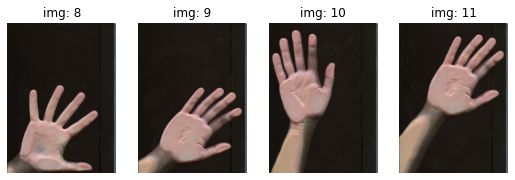

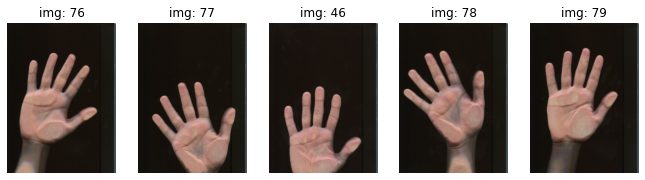

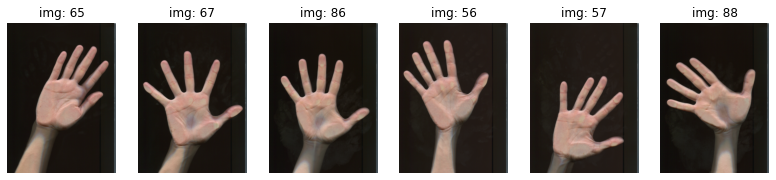

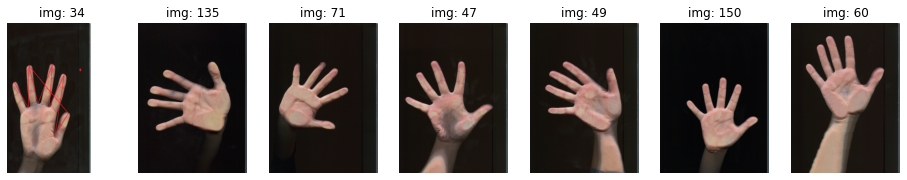

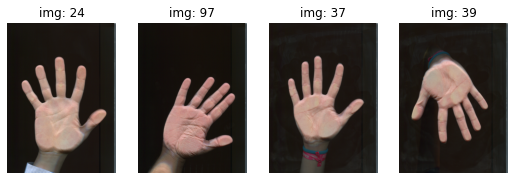

...

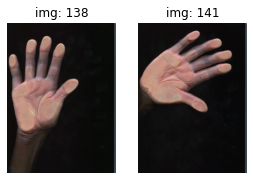

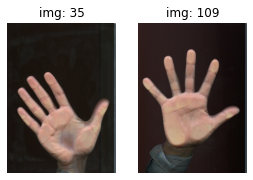

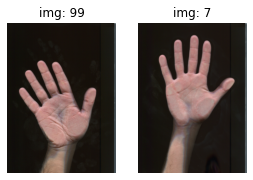

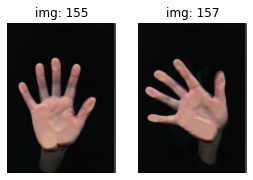

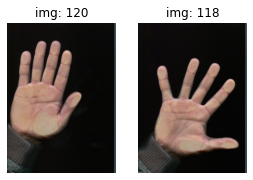

In [25]:
showing.show_clusters_images(clusters, images, images_names)